In [67]:
import numpy as np 
import pandas as pd 
import tensorflow as tf
import seaborn as sns
import matplotlib.pyplot as plt 

In [68]:
dataset = pd.read_csv('nasa.csv')
# Checking missing values
dataset.isnull().sum()

Neo Reference ID                0
Name                            0
Absolute Magnitude              0
Est Dia in KM(min)              0
Est Dia in KM(max)              0
Est Dia in M(min)               0
Est Dia in M(max)               0
Est Dia in Miles(min)           0
Est Dia in Miles(max)           0
Est Dia in Feet(min)            0
Est Dia in Feet(max)            0
Close Approach Date             0
Epoch Date Close Approach       0
Relative Velocity km per sec    0
Relative Velocity km per hr     0
Miles per hour                  0
Miss Dist.(Astronomical)        0
Miss Dist.(lunar)               0
Miss Dist.(kilometers)          0
Miss Dist.(miles)               0
Orbiting Body                   0
Orbit ID                        0
Orbit Determination Date        0
Orbit Uncertainity              0
Minimum Orbit Intersection      0
Jupiter Tisserand Invariant     0
Epoch Osculation                0
Eccentricity                    0
Semi Major Axis                 0
Inclination   

In [66]:
dataset.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 4687 entries, 0 to 4686
Data columns (total 40 columns):
 #   Column                        Non-Null Count  Dtype  
---  ------                        --------------  -----  
 0   Neo Reference ID              4687 non-null   int64  
 1   Name                          4687 non-null   int64  
 2   Absolute Magnitude            4687 non-null   float64
 3   Est Dia in KM(min)            4687 non-null   float64
 4   Est Dia in KM(max)            4687 non-null   float64
 5   Est Dia in M(min)             4687 non-null   float64
 6   Est Dia in M(max)             4687 non-null   float64
 7   Est Dia in Miles(min)         4687 non-null   float64
 8   Est Dia in Miles(max)         4687 non-null   float64
 9   Est Dia in Feet(min)          4687 non-null   float64
 10  Est Dia in Feet(max)          4687 non-null   float64
 11  Close Approach Date           4687 non-null   object 
 12  Epoch Date Close Approach     4687 non-null   int64  
 13  Rel

<AxesSubplot:>

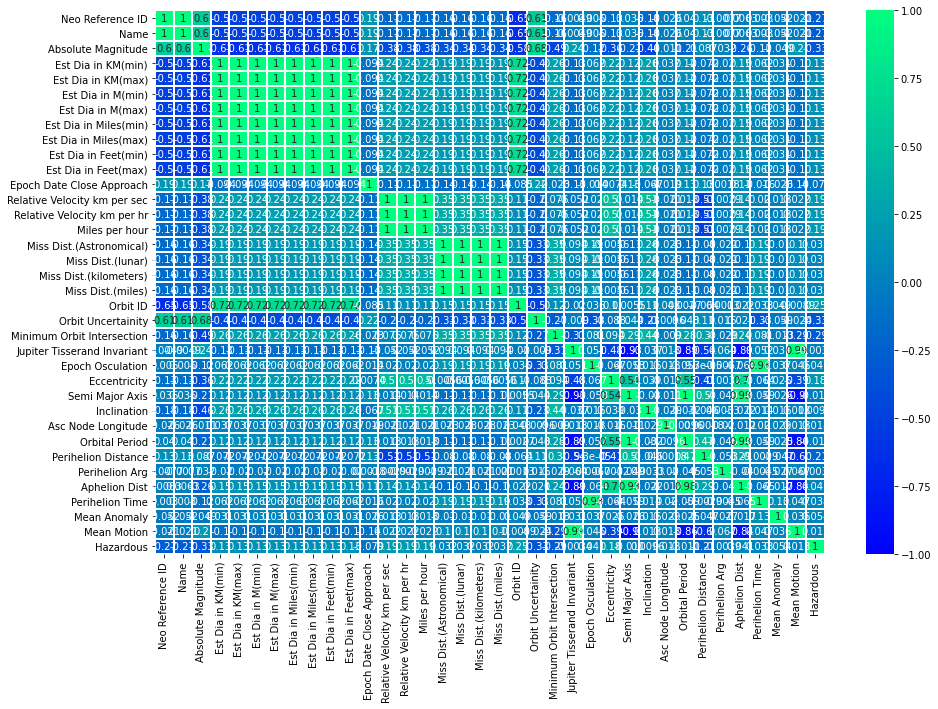

In [38]:
# The correlation matrix denotes some related (redundant) features
# Using meathmap to identify redundant features 
plt.figure(figsize=(15, 10))
corr=dataset.corr()
sns.heatmap(corr, annot=True, 
            vmax = 1, vmin = -1, 
            cmap='winter', linecolor='white', linewidth=1)


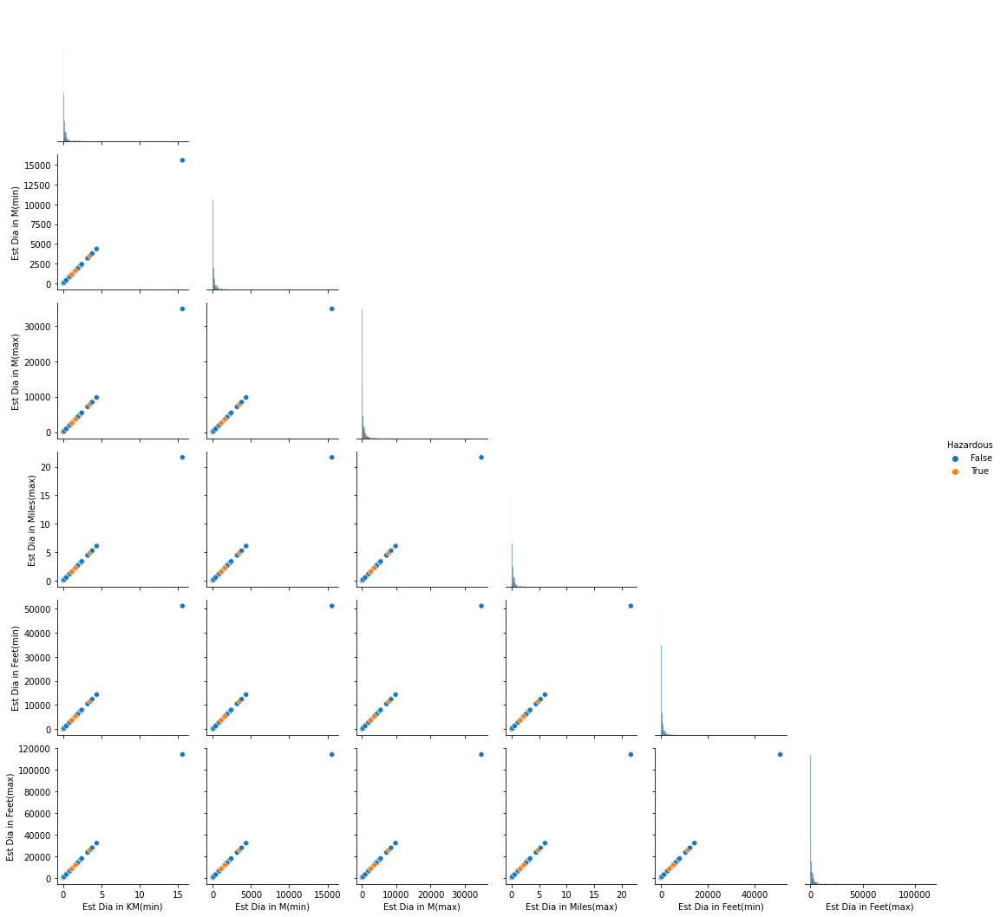

In [39]:
# Showing correlated features with scatter plots
rd_list =[
           'Est Dia in KM(min)',
           'Est Dia in M(min)',
           'Est Dia in M(max)',
           'Est Dia in Miles(max)',
           'Est Dia in Feet(min)',               
           'Est Dia in Feet(max)',
           'Relative Velocity km per sec',                  
           'Relative Velocity km per hr',
           'Miles per hour',
           'Miss Dist.(Astronomical)',
           'Miss Dist.(lunar)',
           'Miss Dist.(kilometers)',
           'Miss Dist.(miles)']
       
redundant_1 = sns.PairGrid(dataset, hue="Hazardous", 
                            x_vars = rd_list[0:6], y_vars = rd_list[0:6],
                            diag_sharey=False, corner=True)
redundant_1.map_lower(sns.scatterplot)
redundant_1.map_diag(sns.histplot)
redundant_1.add_legend()


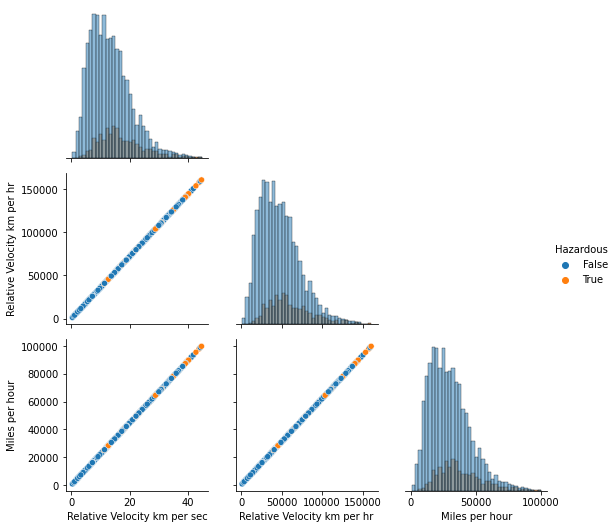

In [40]:
redundant_2 = sns.PairGrid(dataset, hue="Hazardous", 
                            x_vars = rd_list[6:9], y_vars = rd_list[6:9],
                            diag_sharey=False, corner=True)
redundant_2.map_lower(sns.scatterplot)
redundant_2.map_diag(sns.histplot)
redundant_2.add_legend()

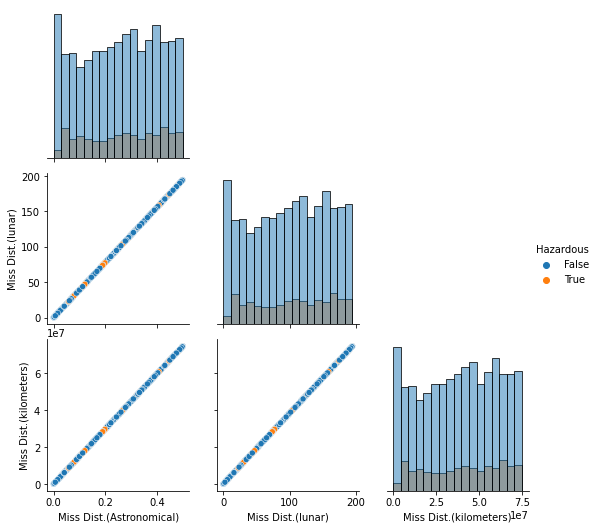

In [41]:
redundant_3 = sns.PairGrid(dataset, hue="Hazardous", 
                            x_vars = rd_list[9:-1], y_vars = rd_list[9:-1],
                            diag_sharey=False, corner=True)
redundant_3.map_lower(sns.scatterplot)
redundant_3.map_diag(sns.histplot)
redundant_3.add_legend()

In [42]:
# Dropping unnecessary features and redundant data which hardly contribute towards classification.

dataset.drop(["Est Dia in M(max)",
              "Est Dia in Feet(max)", 
              "Est Dia in Feet(min)", 
              "Est Dia in Miles(max)", 
              "Est Dia in Miles(min)",
              "Est Dia in KM(max)",
              "Est Dia in KM(min)",
              "Miss Dist.(Astronomical)",
              "Miss Dist.(lunar)",
              "Miss Dist.(miles)",
              "Relative Velocity km per sec",
              "Relative Velocity km per hr",
              "Neo Reference ID",
              "Orbit ID",
              "Name",
              "Close Approach Date",
              "Equinox",
              "Epoch Date Close Approach",
              "Orbiting Body",
              "Orbit Determination Date"], axis=1, inplace=True)
X = dataset.iloc[:,:-1].values
y = dataset.iloc[:,-1].values

In [43]:
# The features that are used for classification are listed below 
cols = list(dataset.columns.values)

for i in range(len(cols)):
    print(i,cols[i])

0 Absolute Magnitude
1 Est Dia in M(min)
2 Miles per hour
3 Miss Dist.(kilometers)
4 Orbit Uncertainity
5 Minimum Orbit Intersection
6 Jupiter Tisserand Invariant
7 Epoch Osculation
8 Eccentricity
9 Semi Major Axis
10 Inclination
11 Asc Node Longitude
12 Orbital Period
13 Perihelion Distance
14 Perihelion Arg
15 Aphelion Dist
16 Perihelion Time
17 Mean Anomaly
18 Mean Motion
19 Hazardous


<AxesSubplot:>

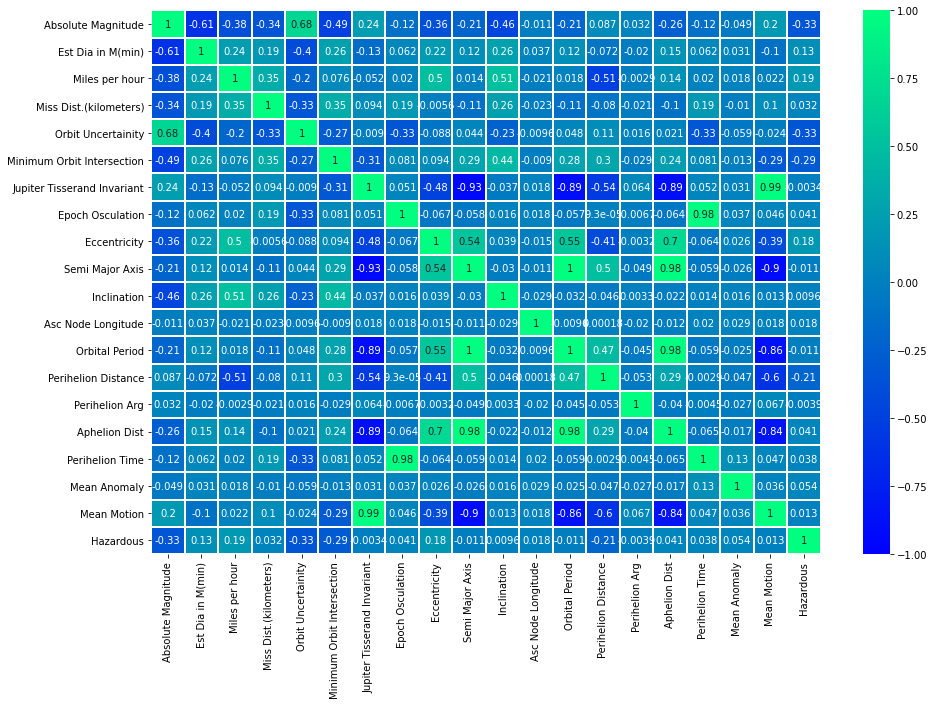

In [44]:
plt.figure(figsize=(15, 10))
corr=dataset.corr()
sns.heatmap(corr, annot = True, 
            vmax = 1, vmin = -1, 
            cmap='winter', linecolor='white', linewidth=1)

In [45]:
#Label Encoding the "Hazardous" column (‘TRUE’ and ‘FALSE’ to 1 and 0)
from sklearn.preprocessing import LabelEncoder
le = LabelEncoder()
y= le.fit_transform(y)

###   Another way : Encoding in dataframe ###
# First checking names and counts of unique rows
# df['Hazardous'].value_counts()
# Then:
# df['Hazardous'] = df['Hazardous'].map({True: 1, False: 0})
###

In [46]:
# observe if data is imbalance
sum(y)/len(y)

0.16108384894388736

In [47]:
# Split the data in to train set and test set
from sklearn.model_selection import train_test_split
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size = 0.2, random_state = 99, stratify = y)

In [48]:
# Feature scaling
from sklearn.preprocessing import StandardScaler
sc = StandardScaler()
X_train = sc.fit_transform(X_train)
X_test = sc.transform(X_test)

In [49]:
#Building ANN
ann = tf.keras.models.Sequential()

#Hidden Layers 
ann.add(tf.keras.layers.Dense(units=32, activation='relu'))
ann.add(tf.keras.layers.Dense(units=32, activation='relu'))

#Output Layers
ann.add(tf.keras.layers.Dense(units=1, activation='sigmoid'))

#Train ANN
ann.compile(optimizer='adam', loss='binary_crossentropy', metrics=['accuracy'])


In [50]:
#Train ANN
ann_history = ann.fit(X_train, y_train, batch_size=32, epochs=50)

Epoch 1/50
118/118 [==============================] - 1s 1ms/step - loss: 0.4253 - accuracy: 0.8122
Epoch 2/50
118/118 [==============================] - 0s 1ms/step - loss: 0.2272 - accuracy: 0.8985
Epoch 3/50
118/118 [==============================] - 0s 1ms/step - loss: 0.1427 - accuracy: 0.9478
Epoch 4/50
118/118 [==============================] - 0s 972us/step - loss: 0.1082 - accuracy: 0.9583
Epoch 5/50
118/118 [==============================] - 0s 857us/step - loss: 0.0989 - accuracy: 0.9596
Epoch 6/50
118/118 [==============================] - 0s 853us/step - loss: 0.0862 - accuracy: 0.9667
Epoch 7/50
118/118 [==============================] - 0s 801us/step - loss: 0.0789 - accuracy: 0.9699
Epoch 8/50
118/118 [==============================] - 0s 818us/step - loss: 0.0668 - accuracy: 0.9758
Epoch 9/50
118/118 [==============================] - 0s 861us/step - loss: 0.0531 - accuracy: 0.9833
Epoch 10/50
118/118 [==============================] - 0s 835us/step - loss: 0.0462 - ac

In [51]:
y_pred = ann.predict(X_test)
y_pred = (y_pred > 0.5)
print(np.concatenate((y_pred.reshape(len(y_pred),1), y_test.reshape(len(y_test),1)),1))

[[1 1]
 [0 0]
 [1 1]
 ...
 [0 0]
 [1 1]
 [0 0]]


In [52]:
from sklearn.metrics import confusion_matrix, accuracy_score
cm= confusion_matrix(y_test, y_pred)
print(cm)
ac = accuracy_score(y_test, y_pred)
print(ac)


[[781   6]
 [ 11 140]]
0.9818763326226013


Text(0, 0.5, 'accuracy')

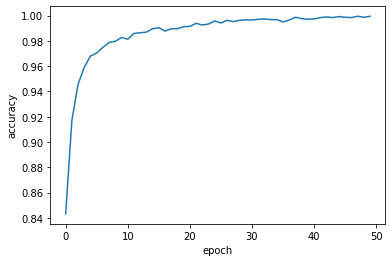

In [53]:

plt.plot(ann_history.history['accuracy'])
plt.xlabel('epoch')
plt.ylabel('accuracy')

<AxesSubplot:xlabel='Hazardous', ylabel='count'>

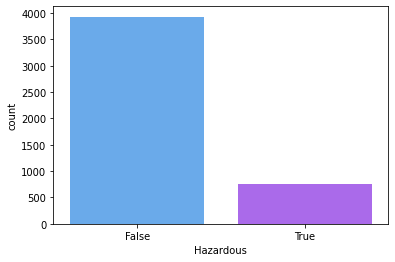

In [54]:
sns.countplot(x='Hazardous',data=dataset, palette='cool')


In [55]:
# Building different classifiers
# Show Accuracy and Confusion Matrix
def classifiers(clf, name):
    y_pred = clf.predict(X_test)
    y_pred_train = clf.predict(X_train)
    
    from sklearn.metrics import accuracy_score, confusion_matrix
    cm_test = confusion_matrix(y_pred, y_test)
    cm_train = confusion_matrix(y_pred_train, y_train)
    accuracy_score_test = accuracy_score(y_pred, y_test)
    accuracy_score_train = accuracy_score(y_pred_train, y_train)
    
    print()
    print('Accuracy of {} for Test Set = {}'.format(name,accuracy_score_test))
    print('Confusion Matrix of {} for Test Set = '.format(name))
    print(cm_train)
    print('Accuracy of {} for Train Set = {}'.format(name, accuracy_score_train))
    print('Confusion Matrix of {} for Train Set = '.format(name))
    print(cm_test)

    print('______________________________________________')
    
    return 



from sklearn.naive_bayes import GaussianNB
clf = GaussianNB()
clf.fit(X_train, y_train)
classifiers(clf, 'Naive Bayes')

from sklearn.neighbors import KNeighborsClassifier
clf = KNeighborsClassifier(n_neighbors =  5, metric = 'minkowski', p = 2)
clf.fit(X_train, y_train)
classifiers(clf, 'K-NN')

from sklearn.svm import SVC
clf = SVC(kernel = 'rbf')
clf.fit(X_train, y_train)
classifiers(clf, 'SVC')


from sklearn.tree import DecisionTreeClassifier 
clf = DecisionTreeClassifier()
clf.fit(X_train, y_train)
classifiers(clf, 'Decision Tree')

from sklearn.ensemble import RandomForestClassifier
clf = RandomForestClassifier()
clf.fit(X_train,  y_train)
classifiers(clf, 'Random Forest')

print()
print('Accuracy of ANN for Test Set = ',ac)
print('Confusion Matrix of ANN for Test Set = ')
print(cm)


Accuracy of Naive Bayes for Test Set = 0.9445628997867804
Confusion Matrix of Naive Bayes for Test Set = 
[[3022   72]
 [ 123  532]]
Accuracy of Naive Bayes for Train Set = 0.9479861296345692
Confusion Matrix of Naive Bayes for Train Set = 
[[756  21]
 [ 31 130]]
______________________________________________

Accuracy of K-NN for Test Set = 0.8923240938166311
Confusion Matrix of K-NN for Test Set = 
[[3067  141]
 [  78  463]]
Accuracy of K-NN for Train Set = 0.94158442251267
Confusion Matrix of K-NN for Train Set = 
[[753  67]
 [ 34  84]]
______________________________________________

Accuracy of SVC for Test Set = 0.9360341151385928
Confusion Matrix of SVC for Test Set = 
[[3088   77]
 [  57  527]]
Accuracy of SVC for Train Set = 0.9642571352360629
Confusion Matrix of SVC for Train Set = 
[[760  33]
 [ 27 118]]
______________________________________________

Accuracy of Decision Tree for Test Set = 0.9957356076759062
Confusion Matrix of Decision Tree for Test Set = 
[[3145    0]
 [

## XGBoost

In [56]:
# Build A Preliminary XGBoost Model
from xgboost import XGBClassifier
classifier = XGBClassifier(objective='binary:logistic',
                           eval_metric="logloss",  # this avoids a warning...
                           missing=None, seed=99,
                           use_label_encoder=False)
classifier.fit(X_train, 
               y_train,
               verbose=True,
               ## the next three arguments set up early stopping.
               early_stopping_rounds=10,
               eval_metric='aucpr',
               eval_set=[(X_test, y_test)])

[0]	validation_0-aucpr:0.99597
[1]	validation_0-aucpr:0.99633
[2]	validation_0-aucpr:0.99659
[3]	validation_0-aucpr:0.99654
[4]	validation_0-aucpr:0.99656
[5]	validation_0-aucpr:0.99648
[6]	validation_0-aucpr:0.99648
[7]	validation_0-aucpr:0.99656
[8]	validation_0-aucpr:0.99652
[9]	validation_0-aucpr:0.99652
[10]	validation_0-aucpr:0.99652
[11]	validation_0-aucpr:0.99640
[12]	validation_0-aucpr:0.99644


XGBClassifier(base_score=0.5, booster='gbtree', colsample_bylevel=1,
              colsample_bynode=1, colsample_bytree=1, eval_metric='logloss',
              gamma=0, gpu_id=-1, importance_type='gain',
              interaction_constraints='', learning_rate=0.300000012,
              max_delta_step=0, max_depth=6, min_child_weight=1, missing=None,
              monotone_constraints='()', n_estimators=100, n_jobs=8,
              num_parallel_tree=1, random_state=99, reg_alpha=0, reg_lambda=1,
              scale_pos_weight=1, seed=99, subsample=1, tree_method='exact',
              use_label_encoder=False, validate_parameters=1, verbosity=None)

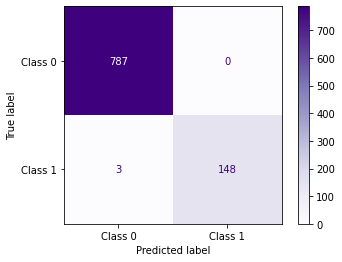

In [57]:
from sklearn.metrics import plot_confusion_matrix
plot_confusion_matrix(classifier, 
                      X_test, 
                      y_test,
                      values_format='d',
                      display_labels=["Class 0", "Class 1"],
                      cmap='Purples' )

In [58]:
# Greid Search

from sklearn.model_selection import GridSearchCV

#Round 1
param_grid = { 
              'max_depth': [3, 4, 5],
              'learning_rate': [0.01, 0.05, 0.1],
              'gamma': [0, 0.25, 0.5, 1.0],
              'reg_lambda': [0, 1.0, 10.0],
              'scale_pos_weight': [1, 2, 3] #if data is imbalanced 
              }
optimal_params = GridSearchCV(estimator=XGBClassifier(
                                 objective='binary:logistic', 
                                 eval_metric="logloss",       # this avoids a warning...
                                 seed=42,
                                 subsample=0.9,               # using a random subset of the data (90%) 
                                 colsample_bytree=0.5,        # using a random subset of the features (columns) (50%)
                                 use_label_encoder=False),
                              param_grid=param_grid,
                              scoring='roc_auc', 
                              verbose=2,                      # verbose = 0 
                              n_jobs = 10,
                              cv = 3)
optimal_params.fit(X_train, 
                   y_train, 
                   early_stopping_rounds=10,                
                   eval_metric='auc',              # use eval_metric='auc' if data is imbalanced 
                   eval_set=[(X_test, y_test)],
                   verbose=False)

print(optimal_params.best_params_)

Fitting 3 folds for each of 324 candidates, totalling 972 fits
{'gamma': 0, 'learning_rate': 0.1, 'max_depth': 5, 'reg_lambda': 0, 'scale_pos_weight': 1}


In [59]:
# Round 2
param_grid = { 
              'max_depth': [5],
              'learning_rate': [0.1, 0.2, 0.3],
              'gamma': [0],
              'reg_lambda': [0, 0.1, 0.2],
              'scale_pos_weight': [1] #if data is imbalanced 
              }
optimal_params = GridSearchCV(estimator=XGBClassifier(
                                 objective='binary:logistic', 
                                 eval_metric="logloss",       # this avoids a warning...
                                 seed=42,
                                 subsample=0.9,               # using a random subset of the data (90%) 
                                 colsample_bytree=0.5,        # using a random subset of the features (columns) (50%)
                                 use_label_encoder=False),
                              param_grid=param_grid,
                              scoring='roc_auc', 
                              verbose=2,                      # verbose = 0 
                              n_jobs = 10,
                              cv = 3)
optimal_params.fit(X_train, 
                   y_train, 
                   early_stopping_rounds=10,                
                   eval_metric='auc',              # use eval_metric='auc' if data is imbalanced 
                   eval_set=[(X_test, y_test)],
                   verbose=False)

print(optimal_params.best_params_)

Fitting 3 folds for each of 9 candidates, totalling 27 fits
{'gamma': 0, 'learning_rate': 0.1, 'max_depth': 5, 'reg_lambda': 0, 'scale_pos_weight': 1}


## Building Optimized XGBoost Model

In [60]:
clf_xgb = XGBClassifier( seed = 99,
                         objective = 'binary:logistic',
                         eval_metric = 'logless',         # this avoids warning...
                         gamma = 0,
                         learning_rate = 0.1,
                         max_depth = 5,
                         reg_lambda = 0,
                         scale_pos_weight = 1,
                         subsample = 0.9,
                         colsample_bytree = 0.5,
                         use_label_encoder = False)
clf_xgb.fit(X_train, 
            y_train, 
            verbose=True, 
            early_stopping_rounds=10,
            eval_metric='aucpr',
            eval_set=[(X_test, y_test)])

[0]	validation_0-aucpr:0.70876
[1]	validation_0-aucpr:0.99260
[2]	validation_0-aucpr:0.99409
[3]	validation_0-aucpr:0.99169
[4]	validation_0-aucpr:0.99473
[5]	validation_0-aucpr:0.99741
[6]	validation_0-aucpr:0.99739
[7]	validation_0-aucpr:0.99631
[8]	validation_0-aucpr:0.99575
[9]	validation_0-aucpr:0.99591
[10]	validation_0-aucpr:0.99579
[11]	validation_0-aucpr:0.99570
[12]	validation_0-aucpr:0.99562
[13]	validation_0-aucpr:0.99560
[14]	validation_0-aucpr:0.99559


XGBClassifier(base_score=0.5, booster='gbtree', colsample_bylevel=1,
              colsample_bynode=1, colsample_bytree=0.5, eval_metric='logless',
              gamma=0, gpu_id=-1, importance_type='gain',
              interaction_constraints='', learning_rate=0.1, max_delta_step=0,
              max_depth=5, min_child_weight=1, missing=nan,
              monotone_constraints='()', n_estimators=100, n_jobs=8,
              num_parallel_tree=1, random_state=99, reg_alpha=0, reg_lambda=0,
              scale_pos_weight=1, seed=99, subsample=0.9, tree_method='exact',
              use_label_encoder=False, validate_parameters=1, verbosity=None)

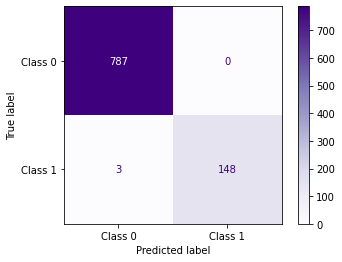

In [61]:
# Visualizing Confusion Matrix
plot_confusion_matrix(clf_xgb, 
                      X_test, 
                      y_test,
                      values_format='d',
                      display_labels=["Class 0", "Class 1"],
                      cmap ='Purples')

In [62]:
from sklearn.metrics import confusion_matrix, accuracy_score
y_pred = clf_xgb.predict(X_test)
cm = confusion_matrix(y_test, y_pred)
print(cm)
accuracy_score(y_test, y_pred)

[[787   0]
 [  3 148]]


0.9968017057569296